In [1]:
import gym
import torch
import gym_nav
import numpy as np

import sys
sys.path.append('../')
from evaluation import *
from model_evaluation import *
from trajectories import *
from shortcut_analysis import *
from explore_analysis import *

from tqdm import tqdm
from umap import UMAP
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances

In [50]:
all_shortcut_res = pickle.load(open('data/shortcut/shortcut_wc_activations', 'rb'))
chks = 40 + np.arange(0, 440, 20)
probs = [0.1, 0.2, 0.4]

In [52]:
sc = 2
p = 0.6
t = 0
chk = 930

exp_name = f'shortcut_sc{sc}p{p}_t{t}'

model, obs_rms = load_chk(exp_name, chk, subdir='shortcut_sc')

env_kwargs = {
    'shortcut_probability': 0.5,
    'shortcut_config': sc,
    'character_reset_pos':  3
}

(None, SubplotGrid(nrows=1, ncols=1, length=1))

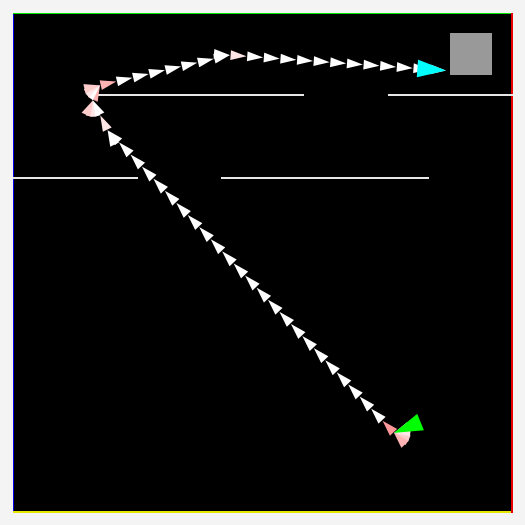

In [83]:
ep = 8
pos = res['data']['pos'][ep]
angle = res['data']['angle'][ep]

shortcuts = res['data']['shortcut'][ep]
kw = env_kwargs.copy()    
kw['shortcut_probability'] = np.array(shortcuts) * 1

env = gym.make('ShortcutNav-v0', render_character=False, **kw)
fig, ax = pplt.subplots()
env.render('human', ax=ax)
ax.format(xlim=[0, 300], ylim=[0, 300])


draw_trajectory(pos, angle, ax=ax)

In [63]:
res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs=env_kwargs,
              data_callback=shortcut_data_callback)

In [4]:
res['data']['shortcut']

[[[True, True]],
 [[True, True]],
 [[True, True]],
 [[True, True]],
 [[True, True]],
 [[True, True]],
 [[True, True]],
 [[True, True]],
 [[True, True]],
 [[True, True]]]

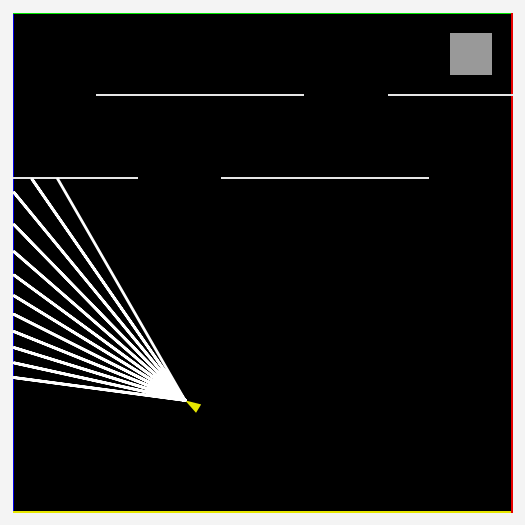

In [16]:
env = gym.make('ShortcutNav-v0', **env_kwargs)
fig, ax = pplt.subplots()
env.reset()
env.render('human', ax=ax)
ax.format(xlim=[0, 300], ylim=[0, 300])


In [47]:
wc = 1.5
p = 0.1
t = 2
chk = 460

exp_name = f'shortcut_wc{wc}p{p}_t{t}'

model, obs_rms = load_chk(exp_name, chk, subdir='shortcut_wc')

env_kwargs = {
    'shortcut_probability': 0.5,
    'wall_colors': wc,
    'character_reset_pos':  3
}

In [48]:
res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs=env_kwargs,
              data_callback=shortcut_data_callback)

(None, SubplotGrid(nrows=1, ncols=1, length=1))

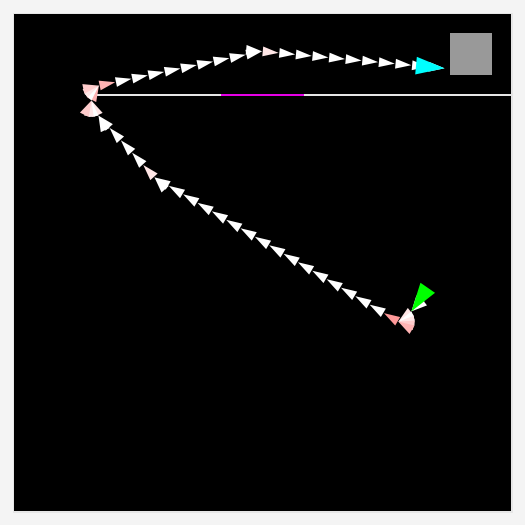

In [58]:
ep = 8
pos = res['data']['pos'][ep]
angle = res['data']['angle'][ep]

shortcuts = res['data']['shortcut'][ep]
kw = env_kwargs.copy()    
kw['shortcut_probability'] = np.array(shortcuts) * 1

env = gym.make('ShortcutNav-v0', render_character=False, **kw)
fig, ax = pplt.subplots()
env.render('human', ax=ax)
ax.format(xlim=[0, 300], ylim=[0, 300])


draw_trajectory(pos, angle, ax=ax)

In [ ]:
env = gym.make('ShortcutNav-v0', **env_kwargs)
fig, ax = pplt.subplots()
env.reset()
env.render('human', ax=ax)
ax.format(xlim=[0, 300], ylim=[0, 300])


In [183]:
%run shortcut_analysis

In [184]:
chks = 40 + np.arange(0, 440, 20)
probs = [0.1, 0.2, 0.4]
all_shortcut_res = {}

for p in probs:
    for t in range(3):
        key = f'{p}_{t}'
        exp_name = f'shortcut_wc1.5p{p}'
        if key in all_shortcut_res:
            continue

        all_shortcut_res[key] = test_shortcut_activations_chks(exp_name=exp_name, trial=t,
                                                               subdir='shortcut_wc', chks=chks,
                                                               env_kwargs={'wall_colors': 1.5})
        pickle.dump(all_shortcut_res, open('data/shortcut/shortcut_wc_activations', 'wb'))

  0%|                                                                                           | 0/22 [00:00<?, ?it/s]C:\Users\14and\anaconda3\lib\site-packages\umap\spectral.py:260: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
  5%|███▊                                                                               | 1/22 [00:44<15:43, 44.95s/it]C:\Users\14and\anaconda3\lib\site-packages\umap\spectral.py:260: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
100%|██████████████████████████████████████████████████████████████████████████████████| 22/22 [10:39<00:00, 29.07s/it]


## Just check shortcut use rate

In [63]:
chks = 40 + np.arange(0, 440, 20)
probs = [0.1, 0.2, 0.4]
all_shortcut_use_rates = {}

for p in probs:
    for t in range(3):
        key = f'{p}_{t}'
        exp_name = f'shortcut_wc1.5p{p}'
        shortcut_use_rates = []
        for chk in tqdm(chks):
            model, obs_rms = load_chk(exp_name, chk, trial=t, subdir='shortcut_wc')
            shortcut_use_rates.append(test_shortcut_use_rate(model, obs_rms, env_kwargs={'wall_colors': 1.5}))
            
        all_shortcut_use_rates[key] = shortcut_use_rates
        pickle.dump(all_shortcut_use_rates, open('data/shortcut/shortcut_wc1.5_userates', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 22/22 [06:03<00:00, 16.51s/it]


# Shortcut forcing

### Generate actions to copy

In [12]:
model, obs_rms = load_chk('shortcutnav_fcp0.1reset3batch64', chk=460, trial=2)
res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', env_kwargs={'character_reset_pos': 3, 'shortcut_probability': 0.5},
         data_callback=shortcut_data_callback, with_activations=True, num_episodes=100, seed=1)
forced_actions = {i: res['actions'][i].reshape(-1) for i in range(len(res['actions']))}

pickle.dump({
    'forced_actions': forced_actions,
    'seed': 1
}, open('data/shortcut/forced_actions', 'wb'))

### Collect data

In [14]:
fa = pickle.load(open('data/shortcut/forced_actions', 'rb'))
forced_actions = fa['forced_actions']
seed = fa['seed']

chks = 40 + np.arange(0, 440, 20)
probs = [0.1, 0.2, 0.4]
all_shortcut_res = {}

savedir = 'data/shortcut/wc1.5_copied'

for p in probs:
    for t in range(3):
        key = f'{p}_{t}'
        exp_name = f'shortcut_wc1.5p{p}'
        if key in os.listdir(savedir):
            continue
        
        shortcut_res = test_shortcut_activations_chks(exp_name=exp_name, trial=t,
                                                   subdir='shortcut_wc', chks=chks,
                                                   env_kwargs={'wall_colors': 1.5},
                                                 umap_min_dist=0.75, skip_activs=False, 
                                                 forced_actions=forced_actions, seed=seed)
        pickle.dump(shortcut_res, open(f'{savedir}/{key}', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 22/22 [09:43<00:00, 26.50s/it]


### Testing

In [29]:
model, obs_rms = load_chk('shortcutnav_fcp0.1reset3batch64', 460, 0)
env_kwargs = {'character_reset_pos': 3, 'shortcut_probability': 0.5}
res1 = evaluate(model, obs_rms, env_name='ShortcutNav-v0', seed=0,
               env_kwargs=env_kwargs, data_callback=shortcut_data_callback, 
               with_activations=True, num_episodes=100)

forced_actions = {i: res1['actions'][i].reshape(-1) for i in range(len(res1['actions']))}
model, obs_rms = load_chk('shortcutnav_fcp0.1reset3batch64', 0, 0)
res2 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', seed=0,
               env_kwargs=env_kwargs, data_callback=shortcut_data_callback,
               forced_actions=forced_actions, with_activations=True, num_episodes=100)

res3 = evaluate(model, obs_rms, env_name='ShortcutNav-v0', seed=0,
               env_kwargs=env_kwargs, data_callback=shortcut_data_callback, 
               with_activations=True, num_episodes=100)


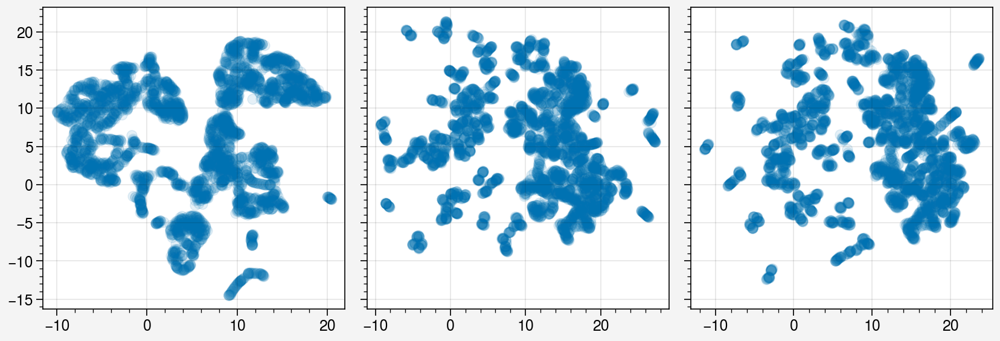

In [32]:
fig, ax = pplt.subplots(ncols=3)

for i, res in enumerate([res1, res2, res2]):
    activs = ep_stack_activations(res, True)
    activ = activs['shared_activations'][1]
    activ2d = UMAP(min_dist=0.5).fit_transform(activ)
    
    ax[i].scatter(activ2d.T[0], activ2d.T[1], alpha=0.1)

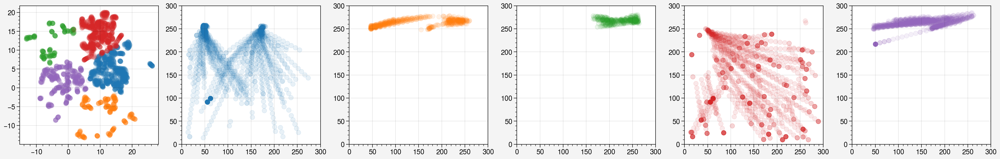

In [37]:
activs = ep_stack_activations(res2, True)
activ = activs['shared_activations'][1]
activ2d = UMAP(min_dist=0.5).fit_transform(activ)

pos = np.vstack(res2['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

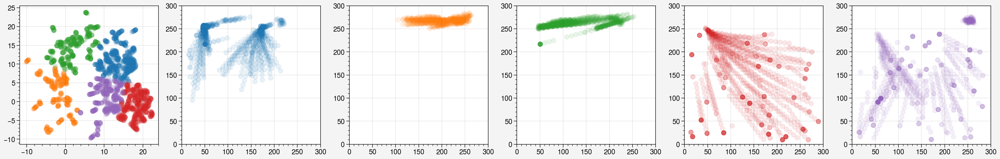

In [42]:
activs = ep_stack_activations(res2, True)
activ = activs['shared_activations'][1]
activ2d = UMAP(min_dist=0.5).fit_transform(activ)

pos = np.vstack(res2['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

In [ ]:
pos = np.vstack(res2['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

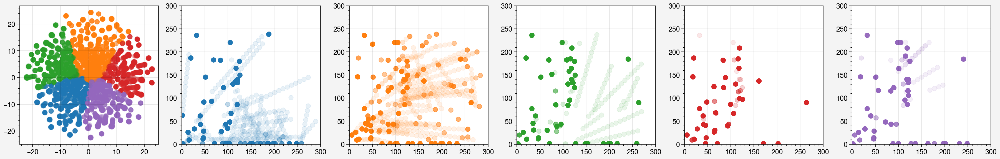

In [39]:
activs = ep_stack_activations(res3, True)
activ = activs['shared_activations'][1]
activ2d = UMAP(min_dist=0.5).fit_transform(activ)


pos = np.vstack(res3['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

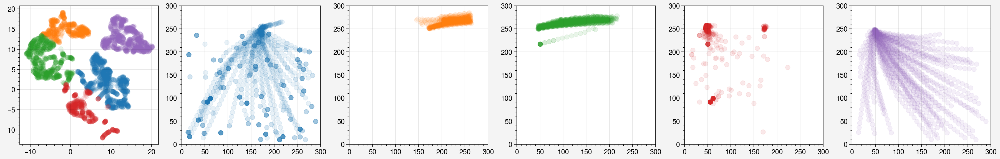

In [41]:
activs = ep_stack_activations(res1, True)
activ = activs['shared_activations'][1]
activ2d = UMAP(min_dist=0.5).fit_transform(activ)

pos = np.vstack(res1['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

## 1 wall color

In [43]:
model, obs_rms = load_chk('shortcut_wc1.5p0.1', 460, 0, subdir='shortcut_wc')
env_kwargs = {'character_reset_pos': 3, 'shortcut_probability': 0.5, 'wall_colors': 1.5}
res1 = evaluate(model, obs_rms, env_name='ShortcutNav-v0', seed=0,
               env_kwargs=env_kwargs, data_callback=shortcut_data_callback, 
               with_activations=True, num_episodes=100)

forced_actions = {i: res1['actions'][i].reshape(-1) for i in range(len(res1['actions']))}
model, obs_rms = load_chk('shortcut_wc1.5p0.1', 0, 0, subdir='shortcut_wc')
res2 = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', seed=0,
               env_kwargs=env_kwargs, data_callback=shortcut_data_callback,
               forced_actions=forced_actions, with_activations=True, num_episodes=100)

res3 = evaluate(model, obs_rms, env_name='ShortcutNav-v0', seed=0,
               env_kwargs=env_kwargs, data_callback=shortcut_data_callback, 
               with_activations=True, num_episodes=100)


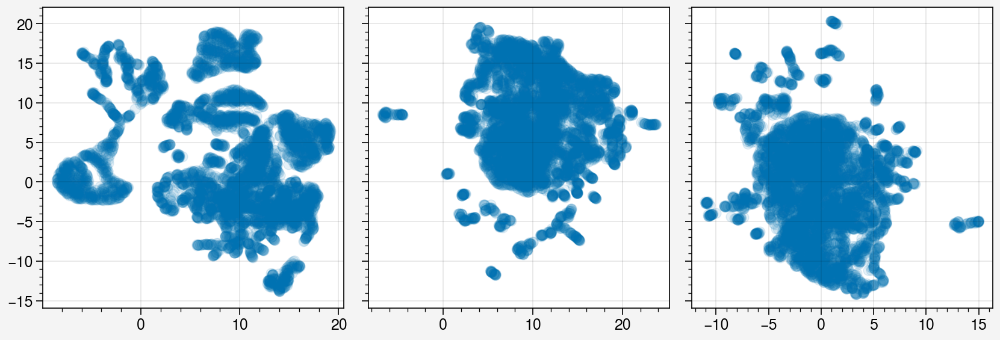

In [44]:
fig, ax = pplt.subplots(ncols=3)

ress = [res1, res2, res2]
activ2ds = []
for i, res in enumerate(ress):
    activs = ep_stack_activations(res, True)
    activ = activs['shared_activations'][1]
    activ2d = UMAP(min_dist=0.5).fit_transform(activ)
    activ2ds.append(activ2d)
    ax[i].scatter(activ2d.T[0], activ2d.T[1], alpha=0.1)

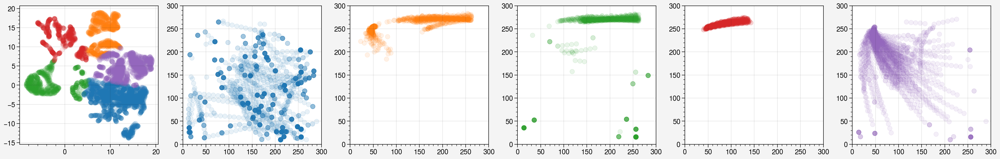

In [45]:
r = 0
activs = ep_stack_activations(ress[r], True)
# activ = activs['shared_activations'][1]
# activ2d = UMAP(min_dist=0.5).fit_transform(activ)
activ2d = activ2ds[r]
pos = np.vstack(ress[0]['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

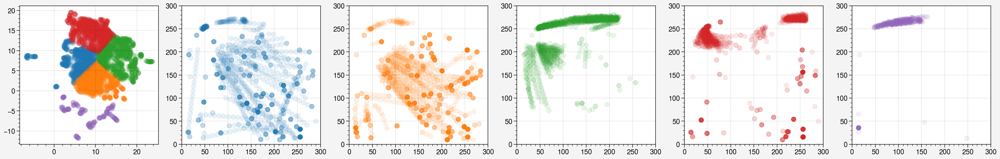

In [46]:
r = 1
activs = ep_stack_activations(ress[r], True)
# activ = activs['shared_activations'][1]
# activ2d = UMAP(min_dist=0.5).fit_transform(activ)
activ2d = activ2ds[r]
pos = np.vstack(ress[0]['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

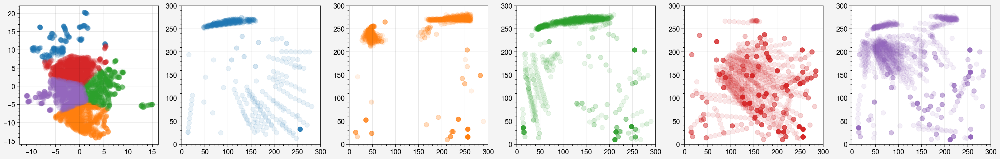

In [47]:
r = 2
activs = ep_stack_activations(ress[r], True)
# activ = activs['shared_activations'][1]
# activ2d = UMAP(min_dist=0.5).fit_transform(activ)
activ2d = activ2ds[r]
pos = np.vstack(ress[0]['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

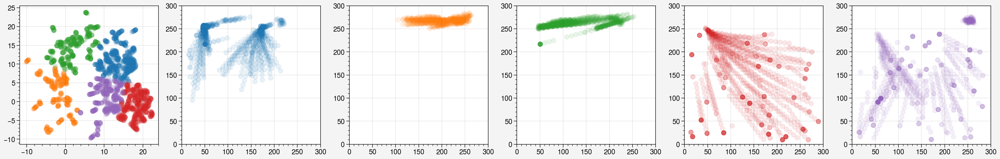

In [42]:
activs = ep_stack_activations(res2, True)
activ = activs['shared_activations'][1]
activ2d = UMAP(min_dist=0.5).fit_transform(activ)

pos = np.vstack(res2['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

In [ ]:
pos = np.vstack(res2['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

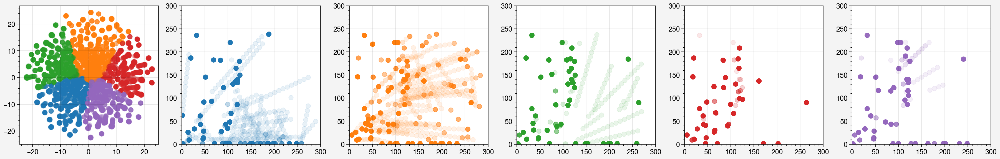

In [39]:
activs = ep_stack_activations(res3, True)
activ = activs['shared_activations'][1]
activ2d = UMAP(min_dist=0.5).fit_transform(activ)


pos = np.vstack(res3['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

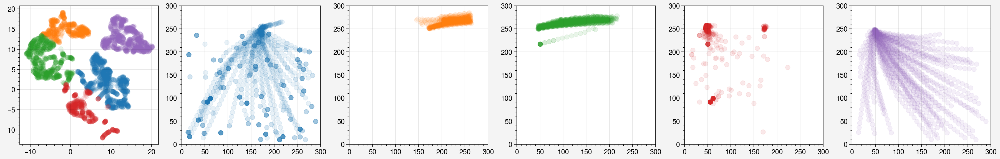

In [41]:
activs = ep_stack_activations(res1, True)
activ = activs['shared_activations'][1]
activ2d = UMAP(min_dist=0.5).fit_transform(activ)

pos = np.vstack(res1['data']['pos'])
kmeans_activ_pos_plot(pos, activ2d)

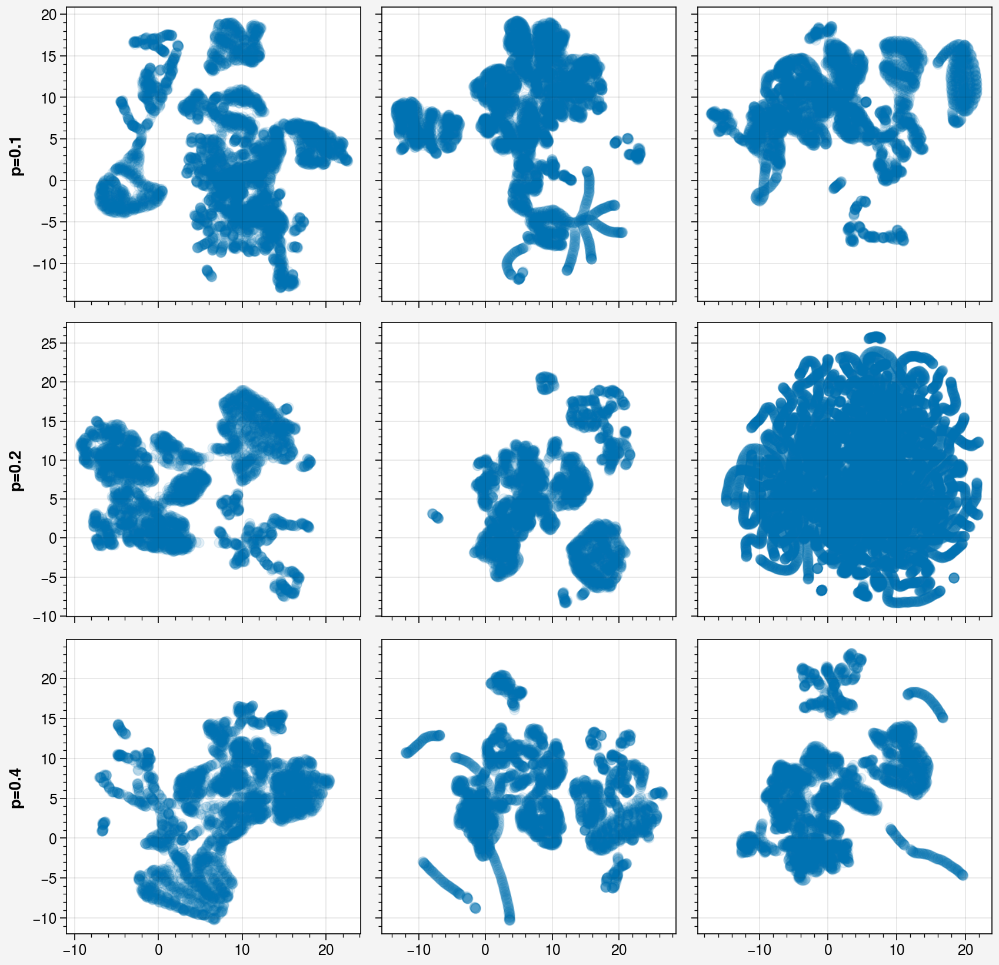

In [49]:
fig, ax = pplt.subplots(nrows=3, ncols=3)

poss = []
activ2ds = []
for i, p in enumerate([0.1, 0.2, 0.4]):
    for t in range(3):
        model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', 460, t, subdir='shortcut_wc')
        env_kwargs = {'character_reset_pos': 3, 'shortcut_probability': 0.5, 'wall_colors': 1.5}
        res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', seed=0,
                       env_kwargs=env_kwargs, data_callback=shortcut_data_callback, 
                       with_activations=True, num_episodes=100)
        activs = ep_stack_activations(res, True)
        activ = activs['shared_activations'][1]
        a = UMAP(min_dist=0.5).fit_transform(activ)
        activ2ds.append(a)
        poss.append(np.vstack(res['data']['pos']))
        
        ax[i, t].scatter(a.T[0], a.T[1], alpha=0.1)

ax.format(leftlabels=[f'p={p}' for p in [0.1, 0.2, 0.4]])

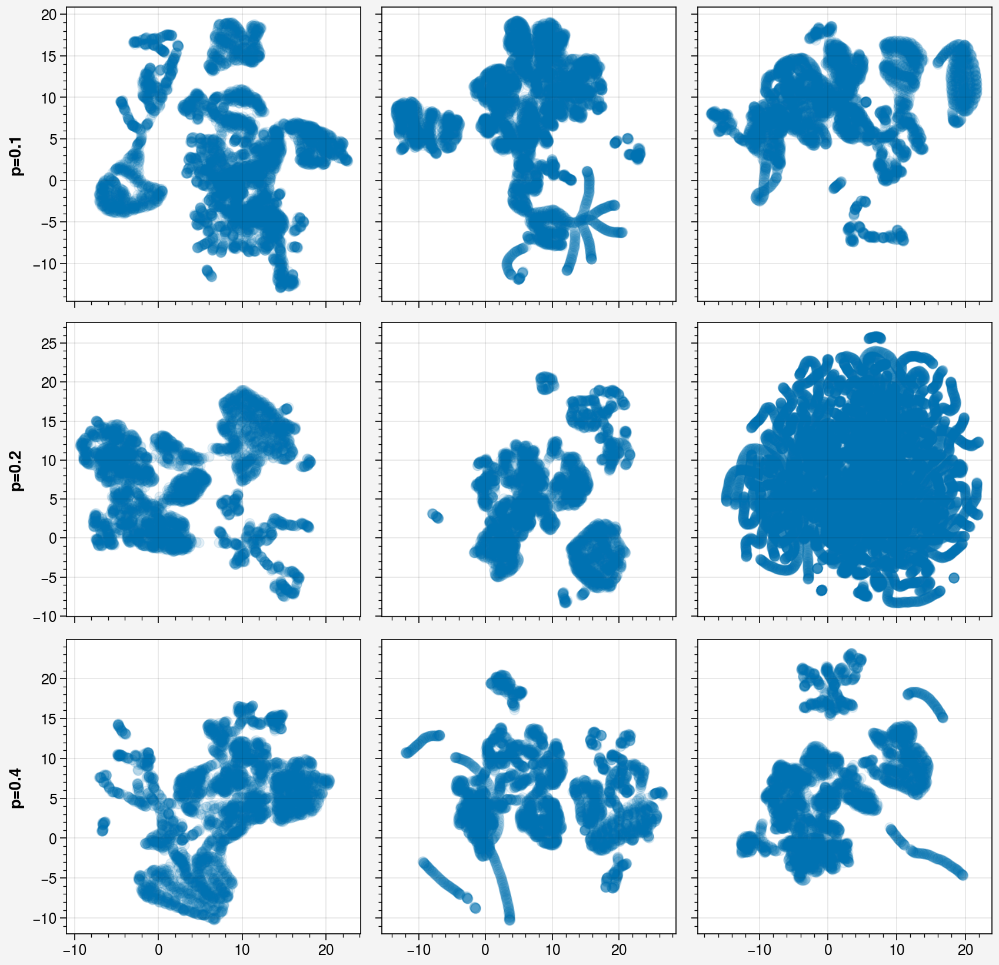

In [49]:
fig, ax = pplt.subplots(nrows=3, ncols=3)

poss = []
activ2ds = []
for i, p in enumerate([0.1, 0.2, 0.4]):
    for t in range(3):
        model, obs_rms = load_chk(f'shortcut_wc1.5p{p}', 460, t, subdir='shortcut_wc')
        env_kwargs = {'character_reset_pos': 3, 'shortcut_probability': 0.5, 'wall_colors': 1.5}
        res = evaluate(model, obs_rms, env_name='ShortcutNav-v0', seed=0,
                       env_kwargs=env_kwargs, data_callback=shortcut_data_callback, 
                       with_activations=True, num_episodes=100)
        activs = ep_stack_activations(res, True)
        activ = activs['shared_activations'][1]
        a = UMAP(min_dist=0.5).fit_transform(activ)
        activ2ds.append(a)
        poss.append(np.vstack(res['data']['pos']))
        
        ax[i, t].scatter(a.T[0], a.T[1], alpha=0.1)

ax.format(leftlabels=[f'p={p}' for p in [0.1, 0.2, 0.4]])

In [51]:
from sklearn.cluster import DBSCAN

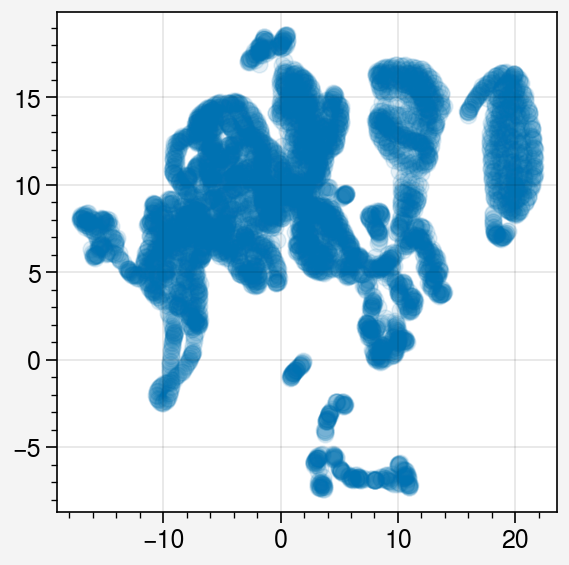

In [50]:
i = 2
a = activ2ds[i]
p = poss[i]

fig, ax = pplt.subplots()
ax.scatter(a.T[0], a.T[1], alpha=0.1)

In [71]:
db = DBSCAN()

labels = db.fit_predict(a)

valid_clusters = np.array([(labels == i).sum() for i in range(n_clusters)])
valid_clusters = valid_clusters > 100
valid_clusters = np.argwhere(valid_clusters).reshape(-1)

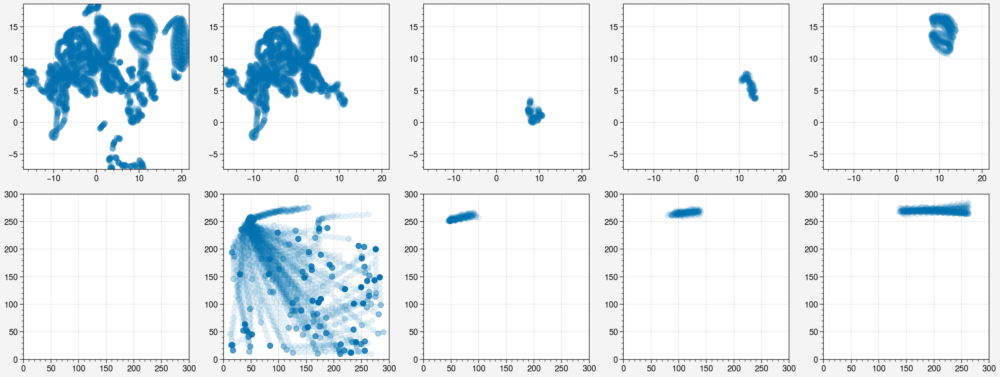

In [72]:
# n_clusters = labels.max() + 1
n_clusters = len(valid_clusters)
fig, ax = pplt.subplots(nrows=2, ncols=n_clusters+1, sharex=False, sharey=False)

xmin, ymin = a.min(axis=0)
xmax, ymax = a.max(axis=0)

ax[0, 0].scatter(a.T[0], a.T[1], alpha=0.1)
for i, c in enumerate(valid_clusters):
    idxs = labels == c
    ax[0, i+1].scatter(a.T[0, idxs], a.T[1, idxs], alpha=0.1)
    ax[1, i+1].scatter(p.T[0, idxs], p.T[1, idxs], alpha=0.1)
    
ax[0, :].format(xlim=[xmin, xmax], ylim=[ymin, ymax])
ax[1, :].format(xlim=[0, 300], ylim=[0, 300])

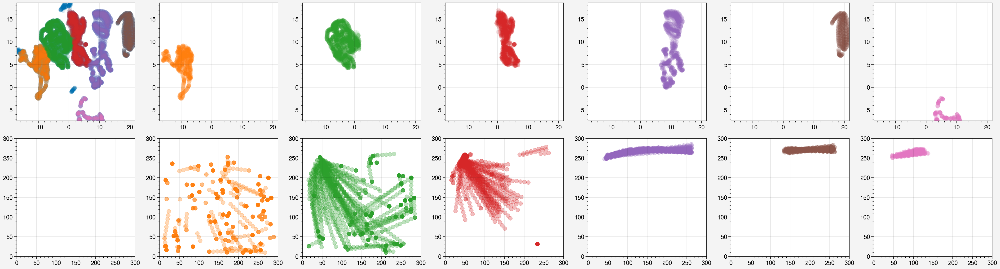

In [118]:
fig, ax = pplt.subplots(nrows=2, ncols=len(clusters)+1, sharex=False, sharey=False)
ax[0, 0].scatter(a.T[0], a.T[1], alpha=0.1)
for i, idxs in enumerate(clusters):
    ax[0, 0].scatter(a.T[0, idxs], a.T[1, idxs], alpha=0.1, color=rgb_colors[i+1])
    ax[0, i+1].scatter(a.T[0, idxs], a.T[1, idxs], alpha=0.1, color=rgb_colors[i+1])
    ax[1, i+1].scatter(p.T[0, idxs], p.T[1, idxs], alpha=0.3, color=rgb_colors[i+1])
    
ax[0, :].format(xlim=[xmin, xmax], ylim=[ymin, ymax])
ax[1, :].format(xlim=[0, 300], ylim=[0, 300])

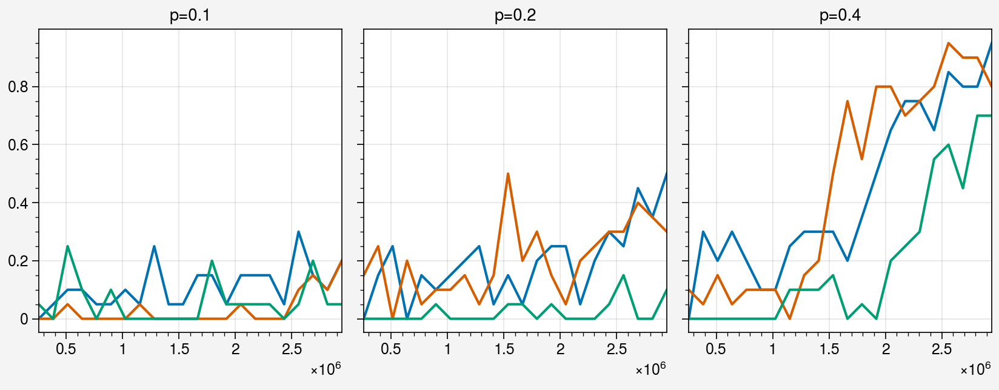

In [186]:
fig, ax = pplt.subplots(ncols=3)
probs = [0.1, 0.2, 0.4]
chks = 40 + np.arange(0, 440, 20)

for i, p in enumerate(probs):
    for t in range(3):
        key = f'{p}_{t}'
        shortcut_res = all_shortcut_res[key]
        shortcut_use_rate = [s['shortcut_use_rate'] for s in shortcut_res]
        ax[i].plot(chks*64*100, shortcut_use_rate)
        
ax.format(title=[f'p={p}' for p in probs])

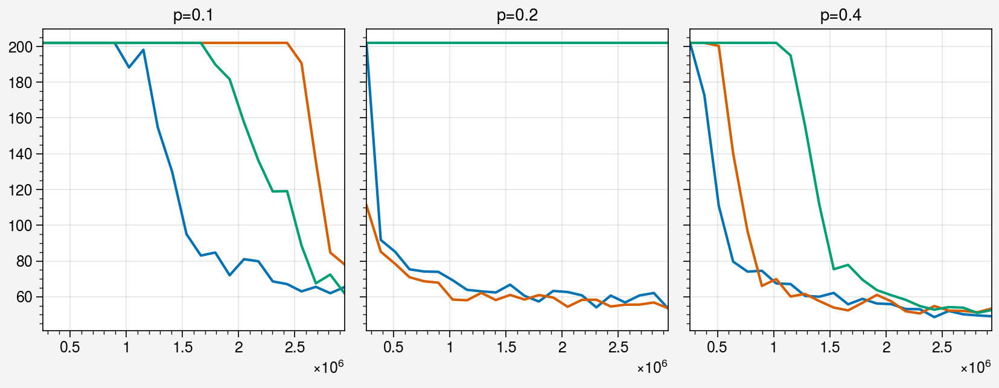

In [185]:
fig, ax = pplt.subplots(ncols=3)
probs = [0.1, 0.2, 0.4]
chks = 40 + np.arange(0, 440, 20)

for i, p in enumerate(probs):
    for t in range(3):
        key = f'{p}_{t}'
        shortcut_res = all_shortcut_res[key]
        shortcut_use_rate = [np.mean([len(e) for e in s['ep_pos']]) for s in shortcut_res]
        ax[i].plot(chks*64*100, shortcut_use_rate)
        
ax.format(title=[f'p={p}' for p in probs])

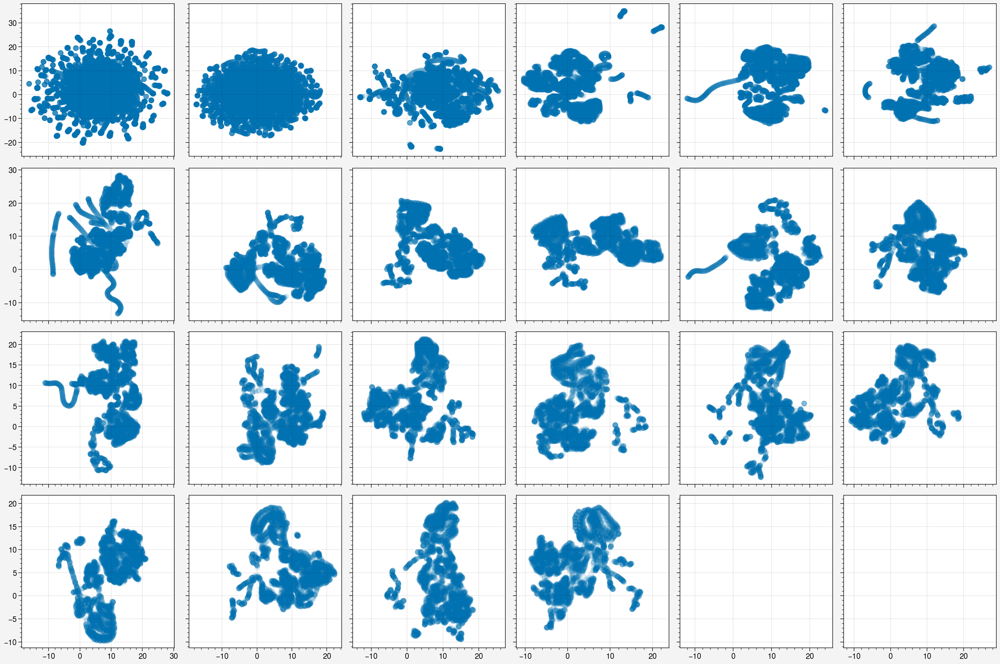

In [189]:
p = 0.4
t = 0
key = f'{p}_{t}'
shortcut_res = all_shortcut_res[key]

fig, ax = pplt.subplots(nrows=4, ncols=6)

for ep in range(len(shortcut_res)):
    res = shortcut_res[ep]
    a = res['activ2d']
    ax[ep].scatter(a.T[0], a.T[1], alpha=0.1)

<a list of 1 Line2D objects>

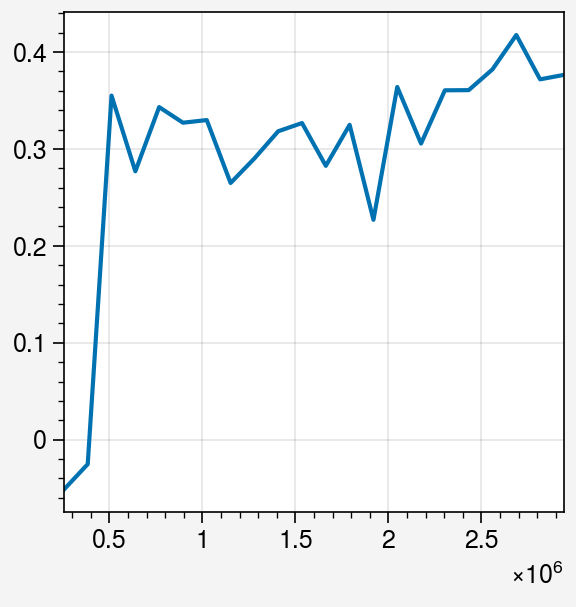

In [195]:
fig, ax = pplt.subplots()

silscores = []
for ep in tqdm(range(len(shortcut_res))):
    res = shortcut_res[ep]
    a = res['activ2d']
    labels, no_cluster = decompose_shortcut_trajectories(res)
    silscores.append(pairwise_silhouette_score(a, labels))

ax.plot(chks*64*100, silscores)


100%|██████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 27.40it/s]


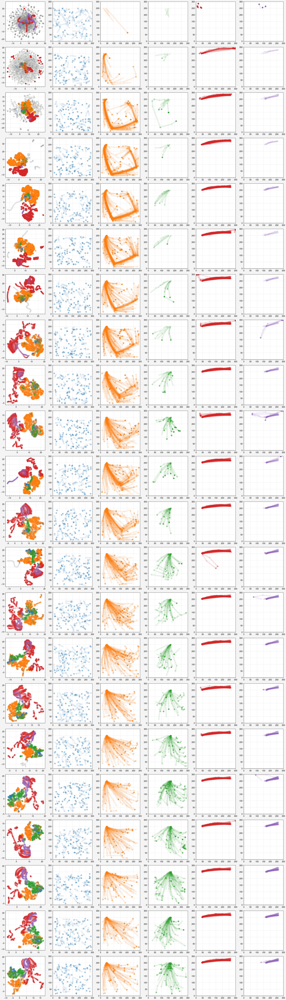

In [196]:
fig, ax = pplt.subplots(nrows=len(shortcut_res), ncols=6, sharex=False, sharey=False)
for ep in tqdm(range(len(shortcut_res))):
    res = shortcut_res[ep]
    labels, no_cluster = decompose_shortcut_trajectories(res)
    a = res['activ2d']
    ax[ep, 0].scatter(a.T[0, no_cluster], a.T[1, no_cluster], color='gray', alpha=0.01)
    kmeans_activ_pos_plot(res['pos'], res['activ2d'], labels=labels, ax=ax[ep, :])

ax[:, 1:].format(xlim=[0, 300], ylim=[0, 300])

In [76]:
all_shortcut_res.keys()

dict_keys(['0.1_0', '0.1_1', '0.1_2', '0.2_0', '0.2_1', '0.2_2', '0.4_0', '0.4_1', '0.4_2'])

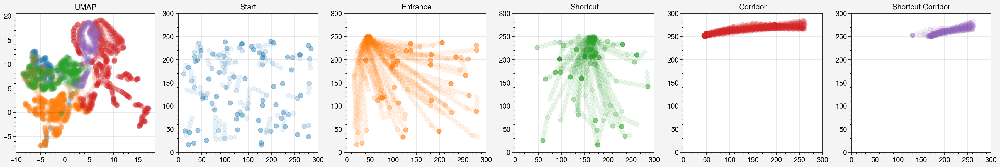

In [82]:
fig, ax = pplt.subplots(ncols=6, sharex=False, sharey=False)

res = all_shortcut_res['0.4_0'][-1]
labels, no_cluster = decompose_shortcut_trajectories(res)
a = res['activ2d']
ax[0].scatter(a.T[0, no_cluster], a.T[1, no_cluster], color='gray', alpha=0.01)
kmeans_activ_pos_plot(res['pos'], res['activ2d'], labels=labels, ax=ax)

ax[1:].format(xlim=[0, 300], ylim=[0, 300])
ax.format(title=['UMAP', 'Start', 'Entrance', 'Shortcut', 'Corridor', 'Shortcut Corridor'])

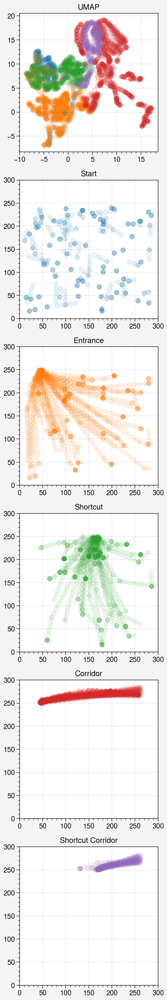

In [99]:
fig, ax = pplt.subplots(nrows=6, sharex=False, sharey=False)

res = all_shortcut_res['0.4_0'][-1]
labels, no_cluster = decompose_shortcut_trajectories(res)
a = res['activ2d']
ax[0].scatter(a.T[0, no_cluster], a.T[1, no_cluster], color='gray', alpha=0.01)
kmeans_activ_pos_plot(res['pos'], res['activ2d'], labels=labels, ax=ax)

ax[1:].format(xlim=[0, 300], ylim=[0, 300])
ax.format(title=['UMAP', 'Start', 'Entrance', 'Shortcut', 'Corridor', 'Shortcut Corridor'])

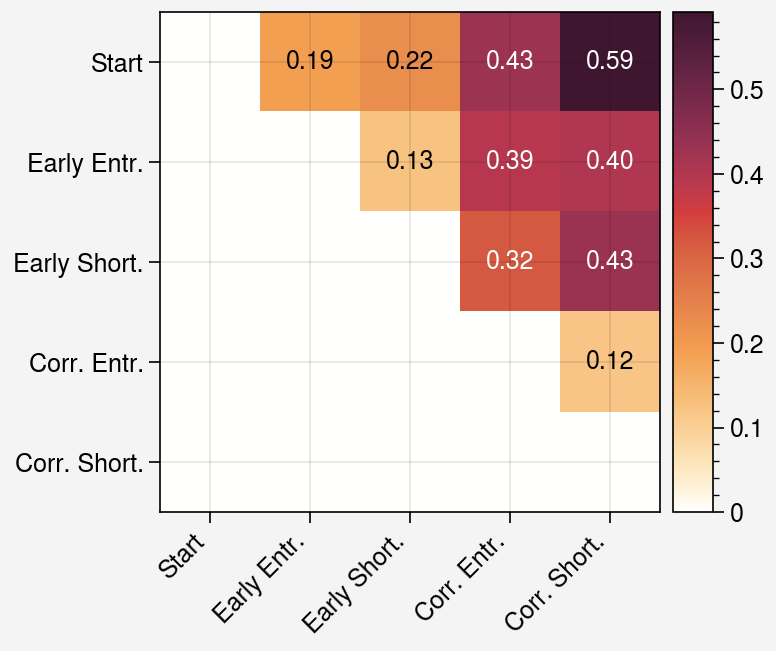

In [97]:
fig, ax = pplt.subplots()

pairwise_silscores = np.zeros((5, 5))

count = 0
for n, p in enumerate(probs):
    for i, j in itertools.product(range(5), range(5)):
        if j <= i:
            continue
            
        for t in range(3):
            key = f'{p}_{t}'
            pairwise_silscores[i, j] += all_silscores[key][-1][i, j]
            if i == 1 and j == 2:
                count += 1


cbar = ax.imshow(pairwise_silscores / count)
ax.colorbar(cbar)

for i, j in itertools.product(range(5), range(5)):
    if j <= i:
        continue
    score = pairwise_silscores[i, j]/count
    color = 'white' if score > 0.3 else 'black'
    ax.text(j, i, f'{score:.2f}', ha='center', va='center', color=color)

ax.format(xformatter=['Start', 'Early Entr.', 'Early Short.','Corr. Entr.', 'Corr. Short.'], xlocator=range(5),
          xrotation=45,
          yformatter=['Start', 'Early Entr.', 'Early Short.','Corr. Entr.', 'Corr. Short.'], ylocator=range(5))



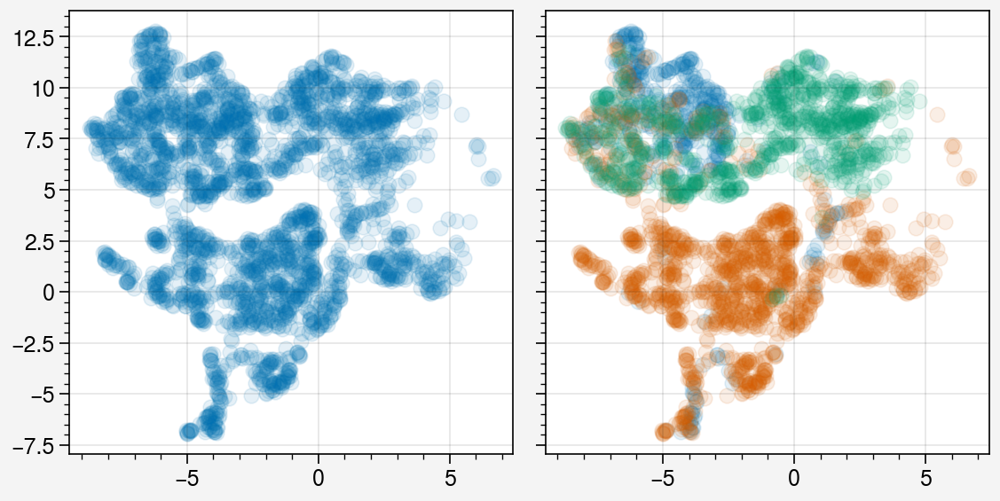

In [201]:
idxs = np.isin(labels, [0, 1, 2])
fig, ax = pplt.subplots(ncols=2)
ax[0].scatter(a.T[0, idxs], a.T[1, idxs], alpha=0.1)
for i in range(3):
    ax[1].scatter(a.T[0, labels==i], a.T[1, labels==i], alpha=0.1)

100%|██████████████████████████████████████████████████████████████████████████████████| 22/22 [00:19<00:00,  1.11it/s]


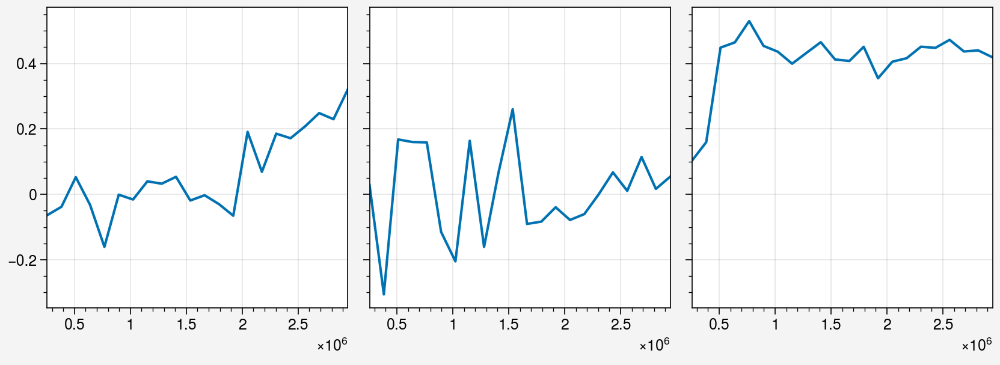

In [204]:
fig, ax = pplt.subplots(ncols=3)

silscores = [[], [], []]
for ep in tqdm(range(len(shortcut_res))):
    res = shortcut_res[ep]
    a = res['activ2d']
    labels, no_cluster = decompose_shortcut_trajectories(res)
    silscore = shortcut_decomposed_silhouettes(a, labels)
    for i in range(3):
        silscores[i].append(silscore[i])

for i in range(3):
    ax[i].plot(chks*64*100, silscores[i])


In [203]:
shortcut_decomposed_silhouettes(a, labels)

[0.3208911, 0.05394989, 0.4186277]

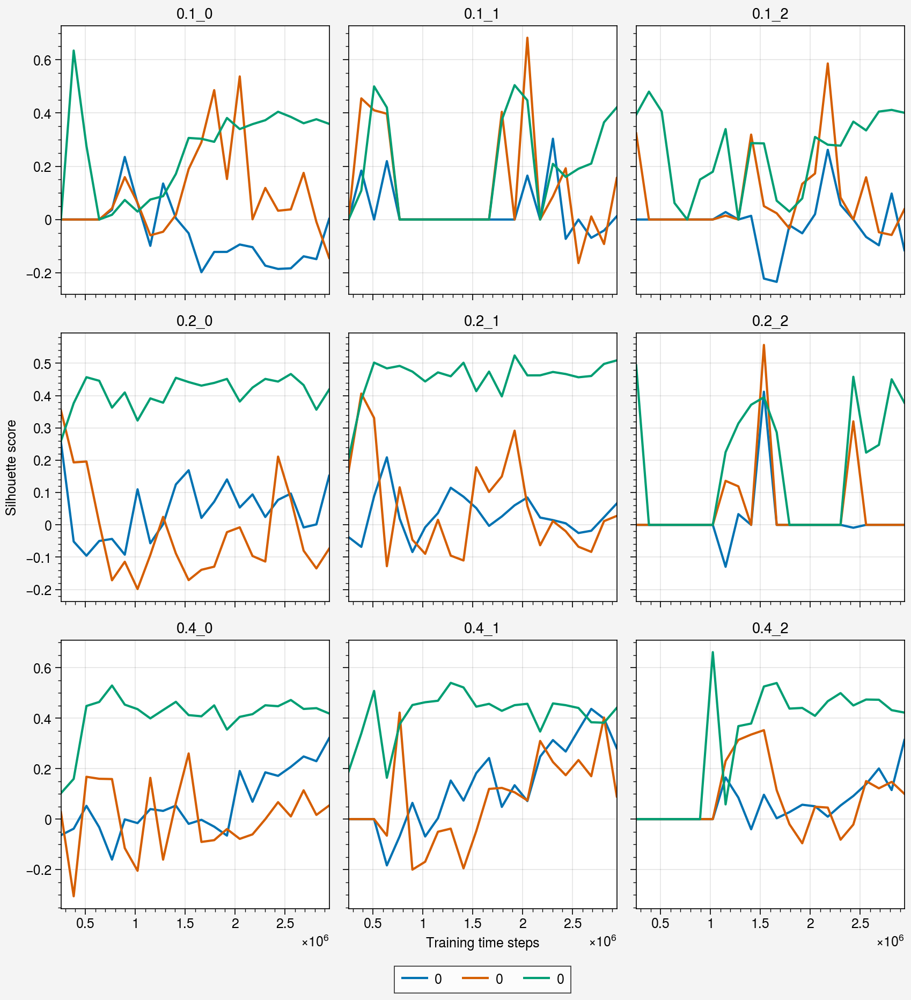

In [214]:
f = lambda: [[], [], []]
figlabels = ['Before shortcut vs. Before entrance', 'After shortcut vs. After entrance', 'Before corridor vs. After corridor']

fig, ax = pplt.subplots(nrows=3, ncols=3)

counter = 0
title = []
silscores = defaultdict(f)
for n, p in enumerate(probs):
    for t in range(3):
        chks = all_chks[batch]
        key = f'{p}_{t}'
        shortcut_res = all_shortcut_res[key]
        
        for res in shortcut_res:
            labels, no_cluster = decompose_shortcut_trajectories(res)
            silscore = shortcut_decomposed_silhouettes(res['activ2d'], labels)
            for j in range(3):
                silscores[key][j].append(silscore[j])
            
        lines = []
        for j in range(3):
            lines.append(ax[counter].plot(chks*64*100, silscores[key][j], label=figlabels[j]))

        counter += 1
        title.append(key)
            
ax.format(title=title, xlabel='Training time steps', ylabel='Silhouette score')
fig.legend(lines, loc='b', ncols=3)

In [215]:
'''3M timesteps of training'''
all_shortcut_res = pickle.load(open('data/shortcut/shortcut_umap_activations', 'rb'))
all_cluster_res = pickle.load(open('data/shortcut/shortcut_cluster_res', 'rb'))
all_chks = {
    32: np.array([80, 120, 160, 200, 240, 280, 320, 360, 400, 440, 480, 520, 560, 600, 640, 680, 720, 760, 800, 840, 880, 920]),
    64: np.array([40, 60, 80, 100, 120, 140, 160, 180, 200, 220, 240, 260, 280, 300, 320, 340, 360, 380, 400, 420, 440, 460]),
}


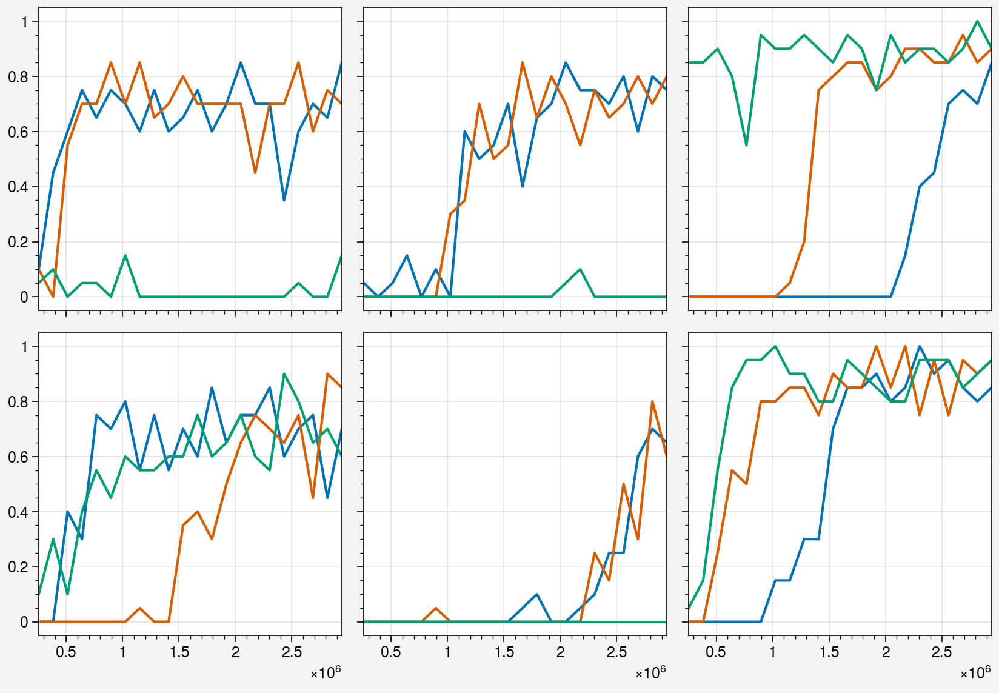

In [206]:

batch_sizes = [32, 64]
probs = [0.1, 0.2, 0.4]

fig, ax = pplt.subplots(nrows=2, ncols=3)

for n, p in enumerate(probs):
    for m, batch in enumerate(batch_sizes):
        for t in range(3):
            key = f'{batch}_{p}_{t}'
            shortcut_res = all_shortcut_res[key]
            shortcut_use_rate = [s['shortcut_use_rate'] for s in shortcut_res]
            ax[m, n].plot(chks*64*100, shortcut_use_rate)
        


In [9]:
labels, _ = decompose_shortcut_trajectories(shortcut_res)
shortcut_decomposed_silhouettes(shortcut_res['activ2d'], labels)

[0.12023323, 0.036275588, 0.2765839]

In [29]:
all_silscores = {}
for n, p in enumerate(probs):
    for t in range(3):
        key = f'{p}_{t}'
        shortcut_res = pickle.load(open(f'data/shortcut/wc1.5_copied/{key}', 'rb'))
        
        silscores = []
        for res in shortcut_res:
            labels, no_cluster = decompose_shortcut_trajectories(res)
            silscore = pairwise_silhouette_score(res['activ2d'], labels)
            silscores.append(silscore)
        all_silscores[key] = silscores
        
pickle.dump(all_silscores, open('data/shortcut/wc1.5_copied/pairwise_silscores', 'wb'))
        

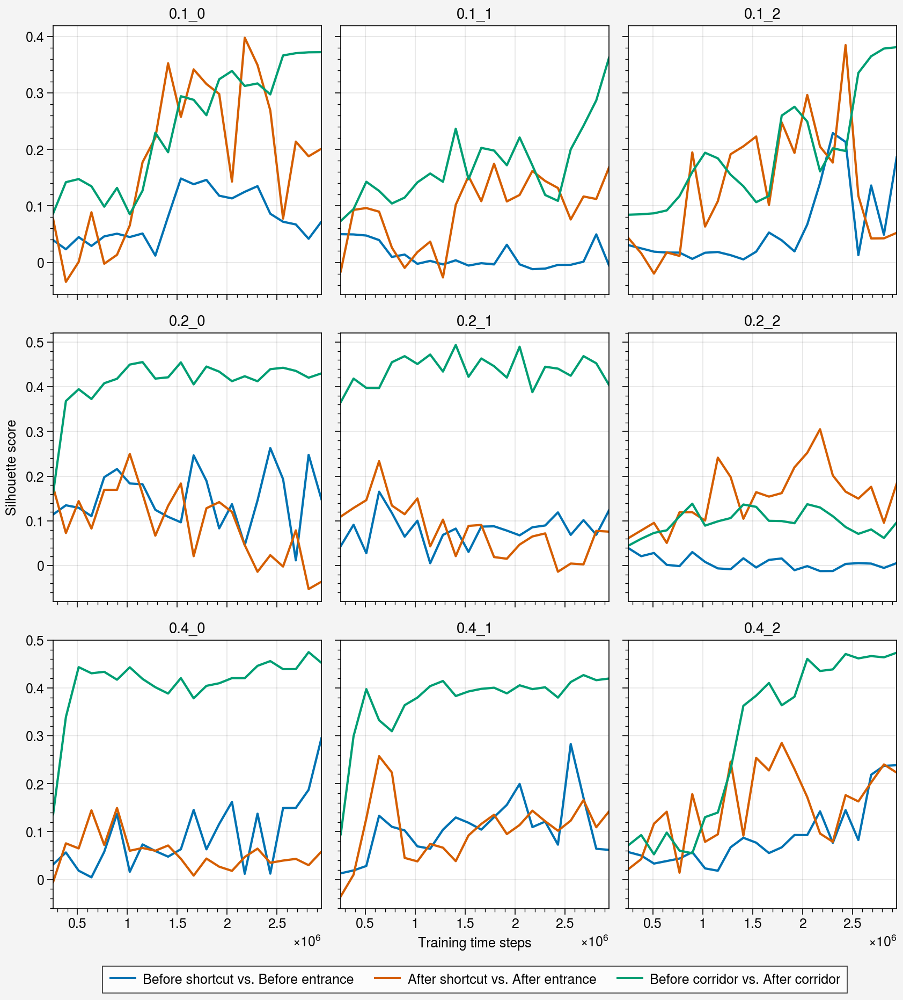

In [20]:
f = lambda: [[], [], []]
figlabels = ['Before shortcut vs. Before entrance', 'After shortcut vs. After entrance', 'Before corridor vs. After corridor']

fig, ax = pplt.subplots(nrows=3, ncols=3)

counter = 0
title = []
silscores = defaultdict(f)
for n, p in enumerate(probs):
    for t in range(3):
        key = f'{p}_{t}'
        shortcut_res = pickle.load(open(f'data/shortcut/wc1.5_copied/{key}', 'rb'))
        
        for res in shortcut_res:
            labels, no_cluster = decompose_shortcut_trajectories(res)
            silscore = shortcut_decomposed_silhouettes(res['activ2d'], labels)
            for j in range(3):
                silscores[key][j].append(silscore[j])
            
        lines = []
        for j in range(3):
            lines.append(ax[counter].plot(chks*64*100, silscores[key][j], label=figlabels[j]))

        counter += 1
        title.append(key)
            
ax.format(title=title, xlabel='Training time steps', ylabel='Silhouette score')
fig.legend(lines, loc='b', ncols=3)

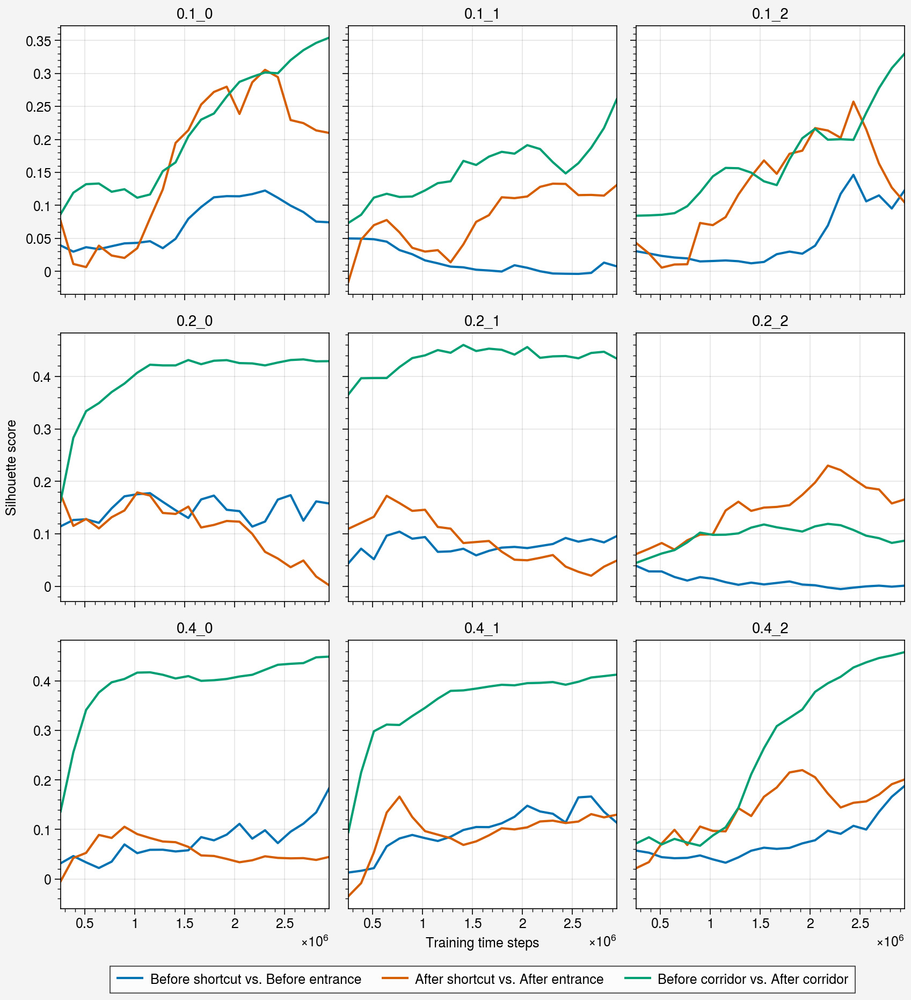

In [21]:
f = lambda: [[], [], []]
figlabels = ['Before shortcut vs. Before entrance', 'After shortcut vs. After entrance', 'Before corridor vs. After corridor']

fig, ax = pplt.subplots(nrows=3, ncols=3)

counter = 0
title = []
for n, p in enumerate(probs):
    for t in range(3):
        key = f'{p}_{t}'
            
        lines = []
        for j in range(3):
            lines.append(ax[counter].plot(chks*64*100, pd.Series(silscores[key][j]).ewm(alpha=0.3).mean(), label=figlabels[j]))

        counter += 1
        title.append(key)
            
ax.format(title=title, xlabel='Training time steps', ylabel='Silhouette score')
fig.legend(lines, loc='b', ncols=3)

In [24]:
def comb_silhouettes2(a, labels):
    silscores = []
    
    # Closeness of shortcut to shortcut corridor vs entrance corridor
    if (labels == 2).sum() > 0 and (labels == 3).sum() > 0 and (labels == 4).sum() > 0:
        score1 = two_set_silhouette_score(a[labels == 2], a[labels == 4])
        score2 = two_set_silhouette_score(a[labels == 2], a[labels == 3])
        silscores.append(score1 - score2)
    else:
        silscore.append(0)
        
        
    # Closeness of entrance to entrance corridor vs shortcut corridor
    if (labels == 1).sum() > 0 and (labels == 3).sum() > 0 and (labels == 4).sum() > 0:
        score1 = two_set_silhouette_score(a[labels == 1], a[labels == 3])
        score2 = two_set_silhouette_score(a[labels == 1], a[labels == 4])
        silscores.append(score1 - score2)
    else:
        silscore.append(0)
        
    return silscores

In [24]:
def comb_silhouettes2(a, labels):
    silscores = []
    
    # Closeness of shortcut to shortcut corridor vs entrance corridor
    if (labels == 2).sum() > 0 and (labels == 3).sum() > 0 and (labels == 4).sum() > 0:
        score1 = two_set_silhouette_score(a[labels == 2], a[labels == 4])
        score2 = two_set_silhouette_score(a[labels == 2], a[labels == 3])
        silscores.append((score1 - score2) / (score1 + score2))
    else:
        silscore.append(0)
        
        
    # Closeness of entrance to entrance corridor vs shortcut corridor
    if (labels == 1).sum() > 0 and (labels == 3).sum() > 0 and (labels == 4).sum() > 0:
        score1 = two_set_silhouette_score(a[labels == 1], a[labels == 3])
        score2 = two_set_silhouette_score(a[labels == 1], a[labels == 4])
        silscores.append((score1 - score2) / (score1 + score2))
    else:
        silscore.append(0)
        
    return silscores

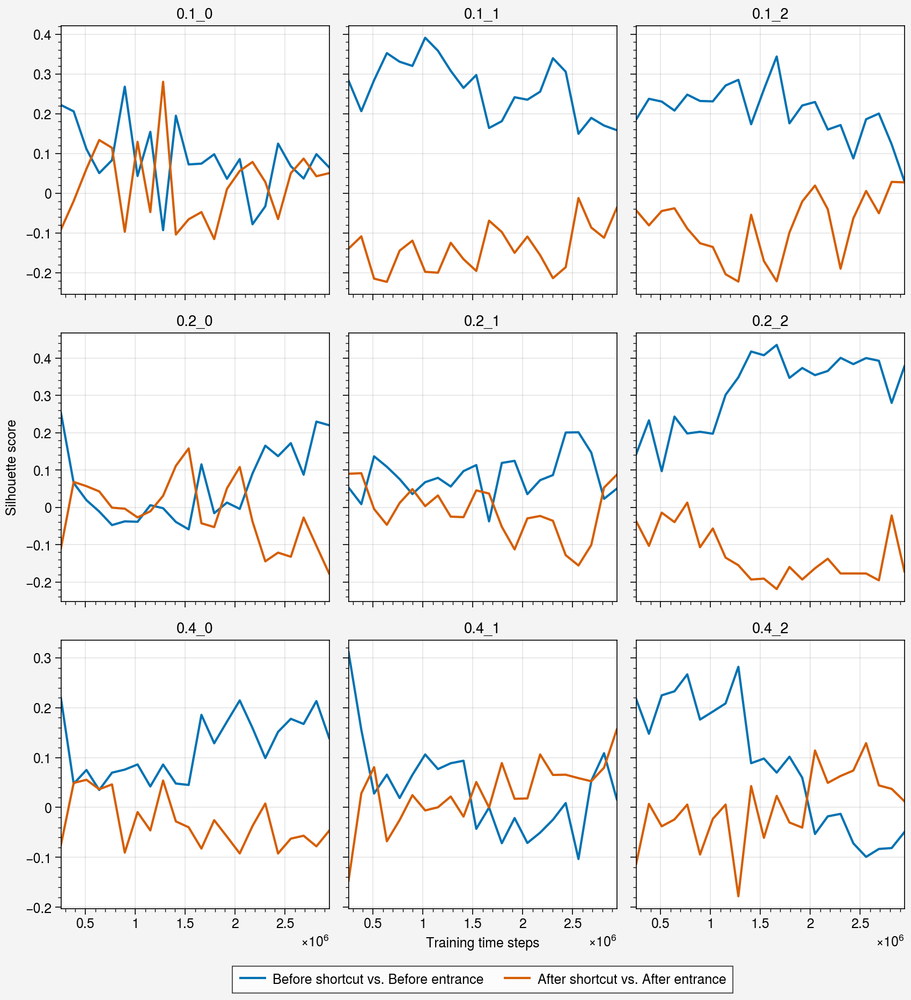

In [25]:
f = lambda: [[], [], []]
figlabels = ['Before shortcut vs. Before entrance', 'After shortcut vs. After entrance', 'Before corridor vs. After corridor']

fig, ax = pplt.subplots(nrows=3, ncols=3)

counter = 0
title = []
silscores = defaultdict(f)
for n, p in enumerate(probs):
    for t in range(3):
        key = f'{p}_{t}'
        shortcut_res = pickle.load(open(f'data/shortcut/wc1.5_copied/{key}', 'rb'))
        
        for res in shortcut_res:
            labels, no_cluster = decompose_shortcut_trajectories(res)
            silscore = comb_silhouettes2(res['activ2d'], labels)
            for j in range(2):
                silscores[key][j].append(silscore[j])
            
        lines = []
        for j in range(2):
            lines.append(ax[counter].plot(chks*64*100, silscores[key][j], label=figlabels[j]))

        counter += 1
        title.append(key)
            
ax.format(title=title, xlabel='Training time steps', ylabel='Silhouette score')
fig.legend(lines, loc='b', ncols=3)

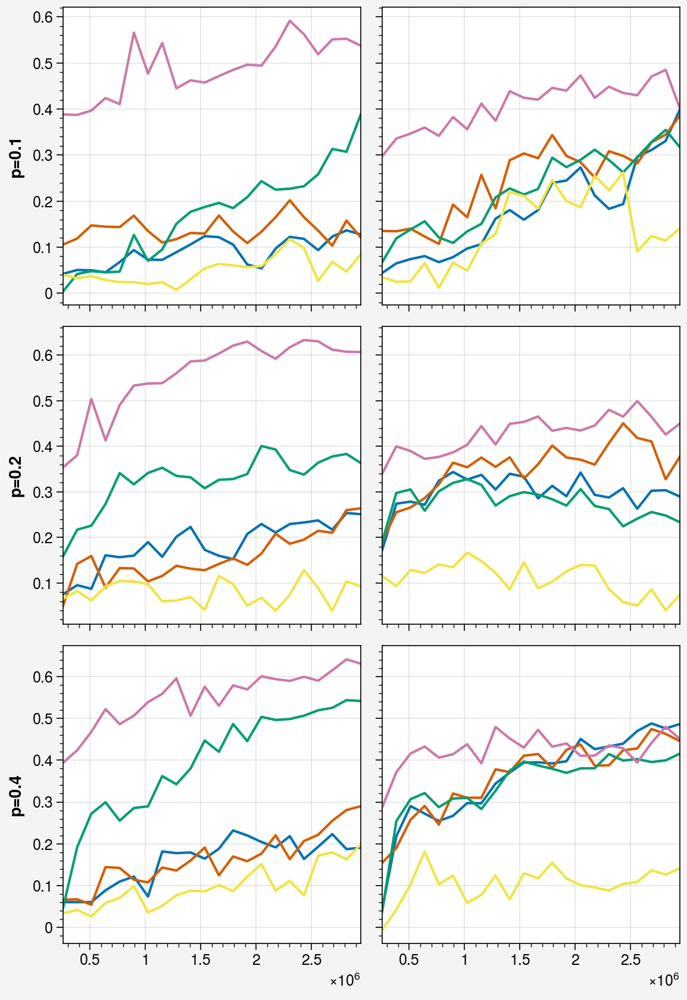

In [31]:
fig, ax = pplt.subplots(ncols=2, nrows=3)

num_chks = len(chks)
for n, p in enumerate(probs):
    count = 0
    for i, j in itertools.product(range(5), range(5)):
        if j <= i:
            continue
            
        ys = []
        for t in range(3):
            key = f'{p}_{t}'
            scores = []
            for chk in range(num_chks):
                scores.append(all_silscores[key][chk][i, j])
            ys.append(scores)
        
        ys = np.mean(ys, axis=0)
        ax[n, count // 5].plot(chks*64*100, ys)
        
        count += 1
        
ax.format(leftlabels=[f'p={p}' for p in probs])

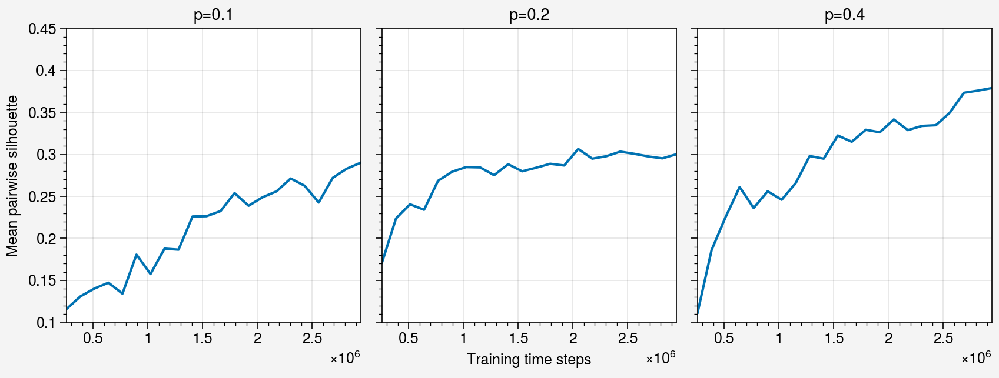

In [103]:
fig, ax = pplt.subplots(ncols=3)

num_chks = len(chks)
for n, p in enumerate(probs):
    count = 0
    ys = []
    
    for i, j in itertools.product(range(5), range(5)):
        if j <= i:
            continue
            
        for t in range(3):
            key = f'{p}_{t}'
            scores = []
            for chk in range(num_chks):
                scores.append(all_silscores[key][chk][i, j])
            ys.append(scores)
        
    ys = np.mean(ys, axis=0)
    ax[n].plot(chks*64*100, ys)
        
ax.format(title=[f'p={p}' for p in probs], xlabel='Training time steps',
          ylabel='Mean pairwise silhouette', ylim=[0.1, 0.45])

In [38]:
fig, ax = pplt.subplots(ncols=3)

num_chks = len(chks)
for n, p in enumerate(probs):
    count = 0
    ys = []
    
    for i, j in itertools.product(range(5), range(5)):
        if j <= i:
            continue
            
        for t in range(3):
            key = f'{p}_{t}'
            scores = []
            for chk in range(num_chks):
                scores.append(all_silscores[key][chk][i, j])
            ys.append(scores)
        
    ys = np.mean(ys, axis=0)
    ax[n].plot(chks*64*100, ys)
        
ax.format(title=[f'p={p}' for p in probs])

0.1791328038832348

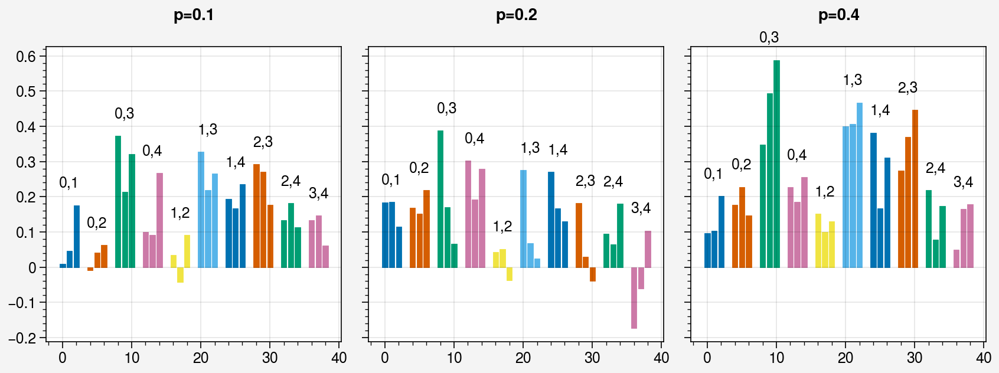

In [44]:
fig, ax = pplt.subplots(ncols=3)

num_chks = len(chks)
for n, p in enumerate(probs):
    count = 0
    
    diffs = []
    for i, j in itertools.product(range(5), range(5)):
        if j <= i:
            continue
            
        ys = []
        for t in range(3):
            key = f'{p}_{t}'
            scores = []
            for chk in range(num_chks):
                scores.append(all_silscores[key][chk][i, j])
                
            scores = pd.Series(scores).ewm(alpha=0.3).mean()
            ys.append(scores.iloc[-1] - scores.iloc[0])
        
        ax[n].bar(count*4 + np.arange(3), ys)
        ax[n].text(count*4-0.5, np.max(ys)+0.05, f'{i},{j}')
        count += 1
        
ax.format(toplabels=[f'p={p}' for p in probs])

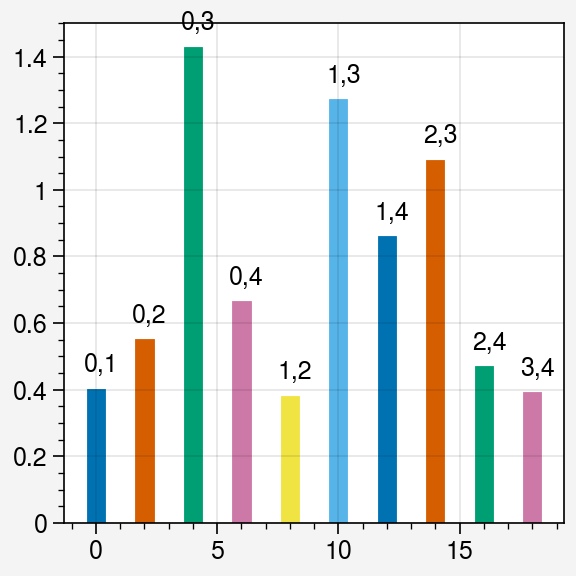

In [48]:
fig, ax = pplt.subplots()

num_chks = len(chks)
for n, p in enumerate(probs):
    count = 0
    
    diffs = np.zeros(10)
    for i, j in itertools.product(range(5), range(5)):
        if j <= i:
            continue
            
        ys = []
        for t in range(3):
            key = f'{p}_{t}'
            scores = []
            for chk in range(num_chks):
                scores.append(all_silscores[key][chk][i, j])
                
            scores = pd.Series(scores).ewm(alpha=0.3).mean()
            diffs[count] += (scores.iloc[-1] - scores.iloc[0])
            
        count += 1

count = 0
for i, j in itertools.product(range(5), range(5)):
    if j <= i:
        continue

    y = diffs[count] / len(probs)*3
    ax.bar([count*2], [y], width=1.5)
    ax.text(count*2-0.5, y+0.05, f'{i},{j}')
    count += 1


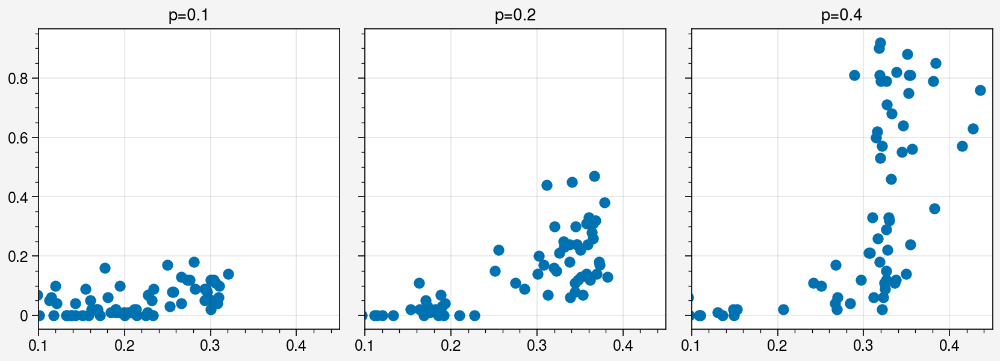

In [188]:
fig, ax = pplt.subplots(ncols=3)

num_chks = len(chks)
for n, p in enumerate(probs):
    xs = []
    ys = []
    for t in range(3):
        key = f'{p}_{t}'
        scores = []
        for i, j in itertools.product(range(5), range(5)):
            s = []
            if j <= i:
                continue
            for chk in range(num_chks):
                s.append(all_silscores[key][chk][i, j])
            scores.append(s)
        scores = np.mean(scores, axis=0)
        xs.append(scores)
        ys.append(all_shortcut_use_rates[key])
    
    xs = np.concatenate(xs)
    ys = np.concatenate(ys)
    ax[n].scatter(xs, ys)
        
ax.format(title=[f'p={p}' for p in probs], xlim=[0.1, 0.45])

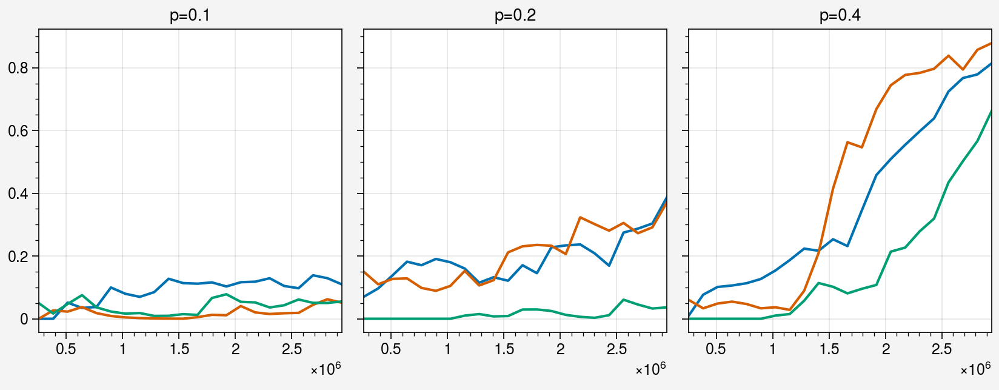

In [74]:
fig, ax = pplt.subplots(ncols=3)

num_chks = len(chks)
for n, p in enumerate(probs):
    xs = []
    ys = []
    for t in range(3):
        key = f'{p}_{t}'
        y = all_shortcut_use_rates[key]
        ax[n].plot(chks*64*100, pd.Series(y).ewm(alpha=0.5).mean())
ax.format(title=[f'p={p}' for p in probs])

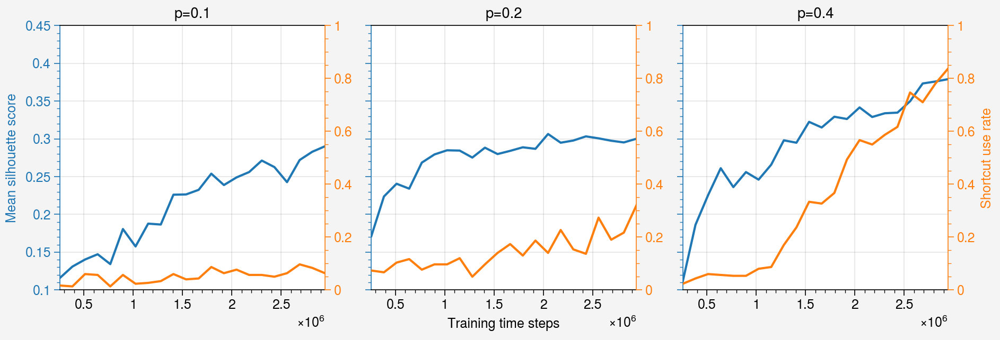

In [175]:
fig, ax = pplt.subplots(ncols=3)
dual = ax.dualy(lambda y: (y-0.1) / 0.35, color=plot_colors[1])

num_chks = len(chks)
for n, p in enumerate(probs):
    count = 0
    ys = []
    ys2 = []
    
    for i, j in itertools.product(range(5), range(5)):
        if j <= i:
            continue
            
        for t in range(3):
            key = f'{p}_{t}'
            scores = []
            for chk in range(num_chks):
                scores.append(all_silscores[key][chk][i, j])
            ys.append(scores)
            ys2.append(all_shortcut_use_rates[key])
        
    lines = []
    ys = np.mean(ys, axis=0)
    lines.append(ax[n].plot(chks*64*100, ys, label='Mean silhouette score', color=rgb_colors[0]))
    ys2 = np.mean(ys2, axis=0)
    lines.append(dual[n].plot(chks*64*100, ys2, label='Shortcut use rate', color=rgb_colors[1]))
        
ax.format(title=[f'p={p}' for p in probs], xlabel='Training time steps',
          ylim=[0.1, 0.45], ycolor=plot_colors[0], ylabel='Mean silhouette score')
dual[-1].format(ylabel='Shortcut use rate')


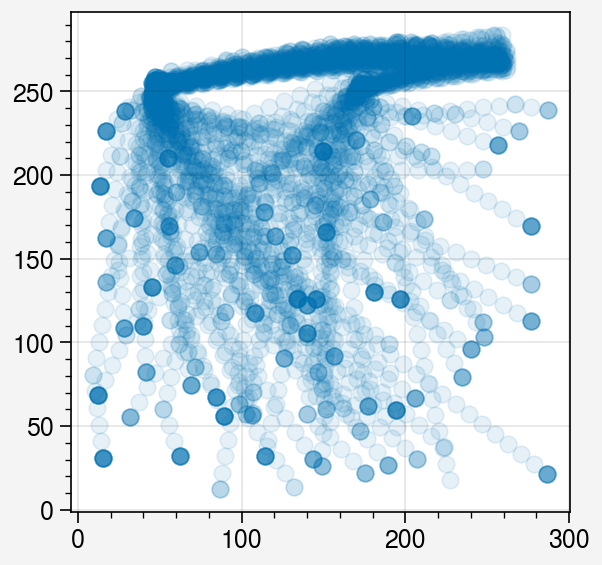

In [102]:
fig, ax = pplt.subplots()
pos = shortcut_res[0]['pos']
ax.scatter(pos.T[0], pos.T[1], alpha=0.1)